In [1]:
import pandas as pd
import seaborn as sbn
import numpy as np

In [155]:
url="https://www.data.gouv.fr/fr/datasets/r/4d3e5a8b-9649-4c41-86ec-5420eb6b530c"
c=pd.read_csv(url, sep=";")
dept=pd.read_csv("https://www.data.gouv.fr/en/datasets/r/dbe8a621-a9c4-4bc3-9cae-be1699c5ff25", sep=",")

In [156]:
c=c.drop(["tx_crib", "tx_A1", "tx_B1", "tx_C1"], axis=1)
c["dep"]=c["dep"].apply(lambda x : x.strip("0"))
c=c.reset_index()
c["semaine"]=c.semaine.apply(lambda x : "-".join(x.split("-")[0:3]))
c["total_cases"]=c.nb_A1+c.nb_B1+c.nb_C1
c.drop(["index"], axis=1, inplace=True)

In [157]:
dept=dept[["latitude","longitude","code_departement"]]
dept = dept.groupby("code_departement").mean()
dept = dept.reset_index()

In [158]:
df=pd.merge(
    c,
    dept,
    how="inner",
    left_on="dep",
    right_on="code_departement",
    left_index=False,
    right_index=False,
    sort=True,
    suffixes=("_x", "_y"),
    copy=True,
    indicator=False,
    validate=None,
)
df.drop(["code_departement"],axis=1,inplace=True)

In [159]:
import pandas as pd 
import folium
from folium.plugins import HeatMapWithTime
from folium.plugins import HeatMap

In [161]:
date_list=list(df.semaine.values)[3000:]
data=[]
for date in date_list:
    val=df.loc[df.semaine==date,["latitude","longitude","total_cases"]].values
    data.append(val.tolist())

In [162]:
hmap = folium.Map(location=[48.8566, 2.3522], zoom_start=5,tiles = "Stamen Terrain" )

hm_wide = HeatMapWithTime(data,
                          index=date_list,
                          auto_play=True,
                          max_opacity=0.7,
                          use_local_extrema=True
)

hmap.add_child(hm_wide)
hmap

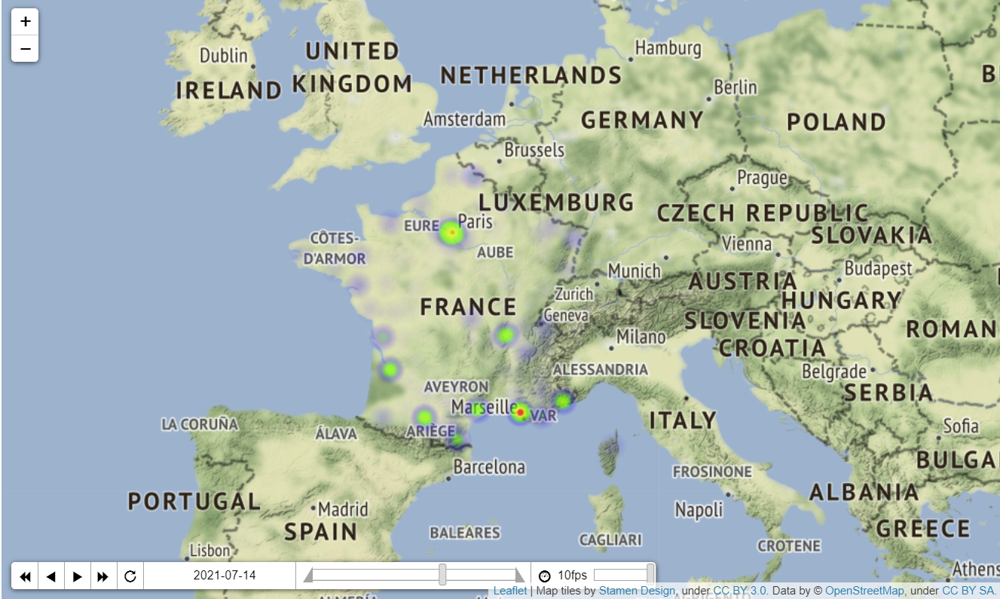